In [32]:
include("State_Space_Model.jl")
using .state_space_model

include("Kalman.jl")
using .kalman

include("MCMC.jl")
using .MCMC

using Random
using LinearAlgebra
using Statistics
using Distributions
using ProgressMeter
using SpecialFunctions
using Plots
using ProgressMeter


In [33]:
# Parameters in θ
θ_elements = ["ρ", "λ_c", "c₁", "c₂", "v_ε, y", "v_ξ, y", "v_κ, y", "σ²_ε, y", "σ²_ξ, y", "σ²_κ, y", "σ²_ε, π", "σ²_ξ, π", "σ²_κ, π"]
n_params = length(θ_elements)

# List of prior distributions (all uniform for now).
prior_distributions = fill("uniform", n_params)
println("Prior distributions: ", prior_distributions)

# matrix of prior hyperparameters.
prior_hyperparameters = repeat([0.0 3.0], n_params, 1)
prior_hyperparameters[5:7, :] .= [-1.0 1.0]
println("Prior hyperparameters:", prior_hyperparameters)

# Create the support matrix in the same way.
support = repeat([0.0 3.0], n_params, 1)
support[1, 2] = 1.0
support[5:7, 2] .= 1.0
support[5:7, 1] .= -1.0
println("Support:", support)


# Combine into a named tuple
prior_info = (
    support = support,
    distributions = prior_distributions,
    parameters = prior_hyperparameters,
)



#States in α
α_elements = [
    "u_t^y", 
    "β_t^y", 
    "u_t^π", 
    "β_t^π", 
    "ψ_{2,t}^y", 
    "ψ_{2,t}^{y*}", 
    "ψ_{1,t}^y", 
    "ψ_{1,t}^{y*}", 
    "ψ_{2,t}^π", 
    "ψ_{2,t}^{π*}", 
    "ψ_{1,t}^π", 
    "ψ_{1,t}^{π*}", 
    "tilde{ψ}_t^y", 
    "tilde{ψ}_{t-1}^y"
]


# True parameters
ρ = 0.6
λ_c = 1.5
c₁ = 0.4
c₂ = 0.1
v_ε = 0.2
v_ξ = -0.1
v_κ = 0.1
σ²_ε_y = 0.8
σ²_ξ_y = 0.5
σ²_κ_y = 1.1
σ²_ε_π = 0.9
σ²_ξ_π = 0.7
σ²_κ_π = 0.3

θ_true = [ρ, λ_c, c₁, c₂, v_ε, v_ξ, v_κ, σ²_ε_y, σ²_ξ_y, σ²_κ_y, σ²_ε_π, σ²_ξ_π, σ²_κ_π]

# cycle_order
cycle_order = 2

Prior distributions: ["uniform", "uniform", "uniform", "uniform", "uniform", "uniform", "uniform", "uniform", "uniform", "uniform", "uniform", "uniform", "uniform"]
Prior hyperparameters:[0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; -1.0 1.0; -1.0 1.0; -1.0 1.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0]
Support:[0.0 1.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; -1.0 1.0; -1.0 1.0; -1.0 1.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0]


2

In [34]:
Z,H,T,R,Q,P_diffuse = state_space(θ_true, cycle_order)
println("Z = ", Z)
println("H = ", H)
println("T = ", T)
println("R = ", R)
println("Q = ", Q)
println("P_diffuse = ", P_diffuse)

# Print shapes
println("Z shape: ", size(Z))
println("H shape: ", size(H))
println("T shape: ", size(T))
println("R shape: ", size(R))
println("Q shape: ", size(Q))
println("P_diffuse shape: ", size(P_diffuse))

Z = [1.0 0.0 0.0 0.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 1.0 0.0 0.0 0.0 0.0 0.0 1.0 0.0 0.0 0.0 0.4 0.1]
H = [0.8 0.2; 0.2 0.9]
T = [1.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 1.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.042442321000621744 0.5984969919624327 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 -0.5984969919624327 0.042442321000621744 0.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0 0.042442321000621744 0.5984969919624327 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0 -0.5984969919624327 0.042442321000621744 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.042442321000621744 0.5984969919624327 1.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 -0.5984969919624327 0.042442321000621744 0.0 1.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.042442321000621744 0.5984969919624327 0.0 0.0;

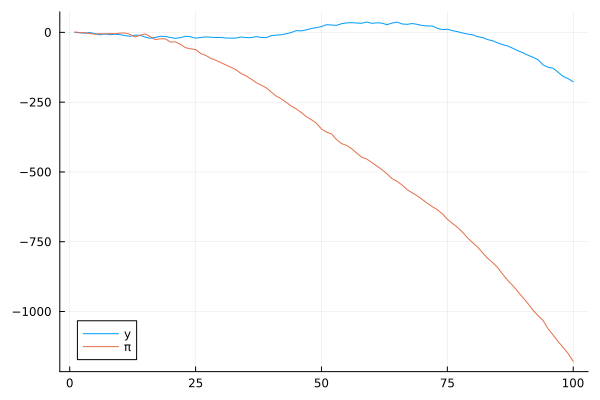

shape of obs = (100, 2)
shape of α = (100, 14)


14×14 Matrix{Bool}:
 1  0  0  0  0  0  0  0  0  0  0  0  0  0
 0  1  0  0  0  0  0  0  0  0  0  0  0  0
 0  0  1  0  0  0  0  0  0  0  0  0  0  0
 0  0  0  1  0  0  0  0  0  0  0  0  0  0
 0  0  0  0  1  0  0  0  0  0  0  0  0  0
 0  0  0  0  0  1  0  0  0  0  0  0  0  0
 0  0  0  0  0  0  1  0  0  0  0  0  0  0
 0  0  0  0  0  0  0  1  0  0  0  0  0  0
 0  0  0  0  0  0  0  0  1  0  0  0  0  0
 0  0  0  0  0  0  0  0  0  1  0  0  0  0
 0  0  0  0  0  0  0  0  0  0  1  0  0  0
 0  0  0  0  0  0  0  0  0  0  0  1  0  0
 0  0  0  0  0  0  0  0  0  0  0  0  1  0
 0  0  0  0  0  0  0  0  0  0  0  0  0  1

In [35]:
n_obs = 100

#simulate data
obs, α = simulate_data(θ_true, cycle_order, n_obs)

# shape of obs
println("shape of obs = ", size(obs))
# shape of α
println("shape of α = ", size(α))

y = obs[:,1]
π = obs[:,2]

# plot data
plot(y, label="y")
plot!(π, label="π")
display(plot!())


α0 = zeros(size(T, 1))
P0 = Matrix(I, size(T, 1), size(T, 1))  # large initial uncertainty



## MCMC

In [36]:
θ_chain, θ_chain_init, α_draws = MCMC_estimation(obs, prior_info, α0, P0, cycle_order;
 iter_init = 40000, 
 burn_init = 20000,
 iter_rec = 30000,
burn_rec = 20000,
θ_init = θ_true,
ω = 0.1)

Initialization Phase 100%|███████████████████████████████| Time: 0:00:28


Initialization Acceptance Rate: 29.82%


Recursion Phase 100%|████████████████████████████████████| Time: 0:01:11


Recursion Acceptance Rate: 32.300000000000004%


([0.5617242479871132 1.685499889389068 … 0.9620295775649834 0.40985080787118466; 0.5617242479871132 1.685499889389068 … 0.9620295775649834 0.40985080787118466; … ; 0.5788913793018207 1.6975264762512567 … 0.7322190838580505 1.741412515512747; 0.5590440711426617 1.6531808578217093 … 0.8767572796673655 1.7964912428927258], [0.5999999999999999 1.5 … 0.7000000000000002 0.29999999999999993; 0.5999999999999999 1.5 … 0.7000000000000002 0.29999999999999993; … ; 0.5556011502250805 1.694772249427637 … 0.7976525951336441 0.5034667479880524; 0.5556011502250805 1.694772249427637 … 0.7976525951336441 0.5034667479880524], [-0.5835128785422063 -0.8988668911762372 … -167.6090256285475 -179.8104955012799; -1.2103305539530995 -1.4691889527948998 … -167.28999137863798 -181.191565036101; … ; 0.4967355309767665 -0.9782480402492864 … -166.64879076052367 -178.53930195993183; 1.3729883501222528 0.35529135583675275 … -166.5674173270428 -178.6704125971683;;; -0.31535401263403084 -1.0244508936372665 … -12.20146987

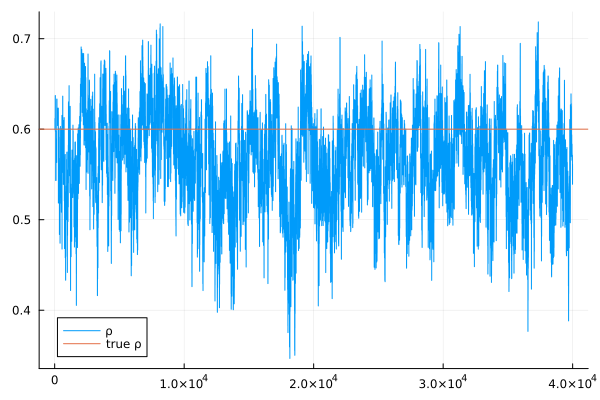

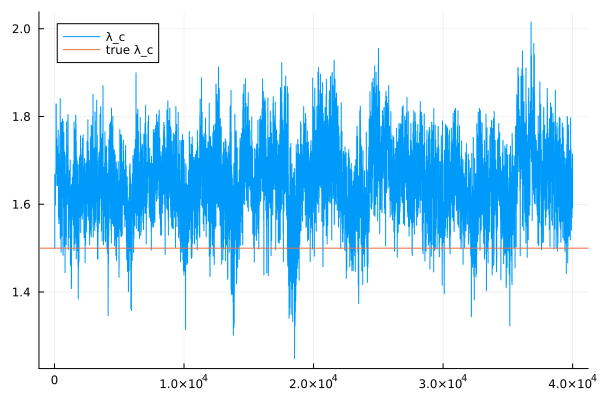

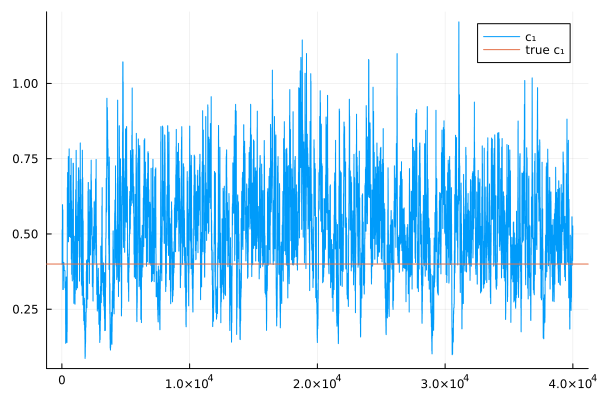

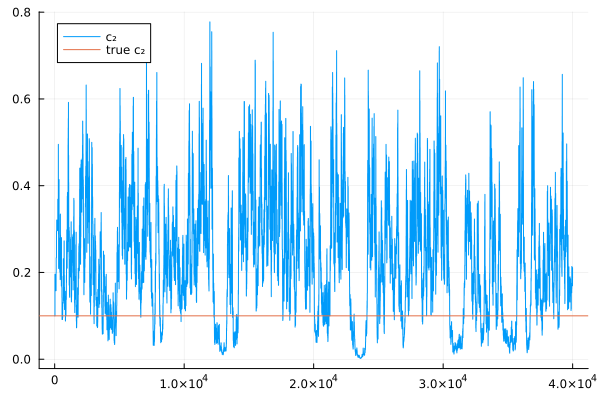

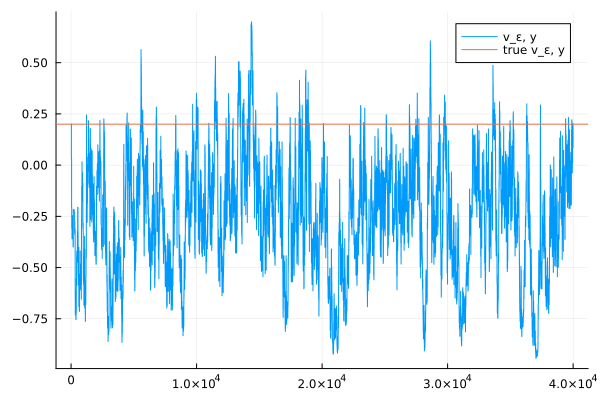

...

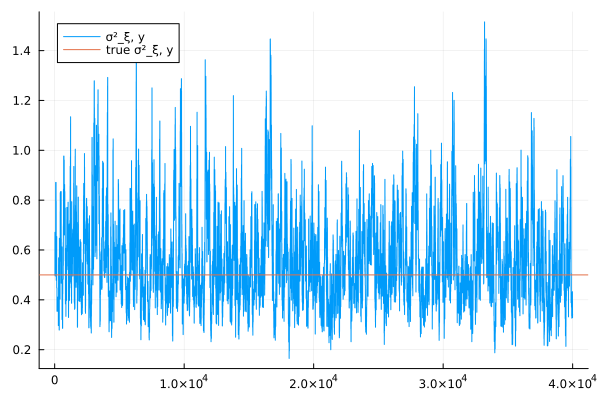

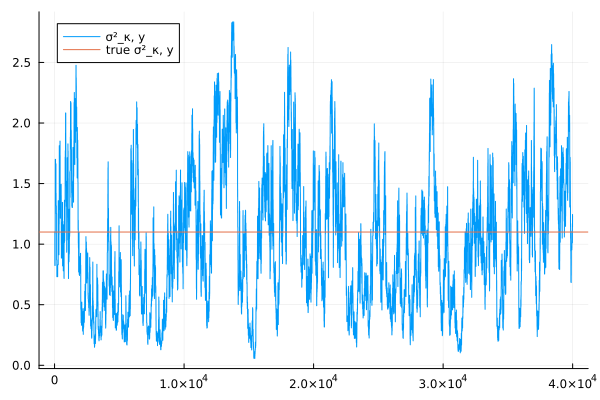

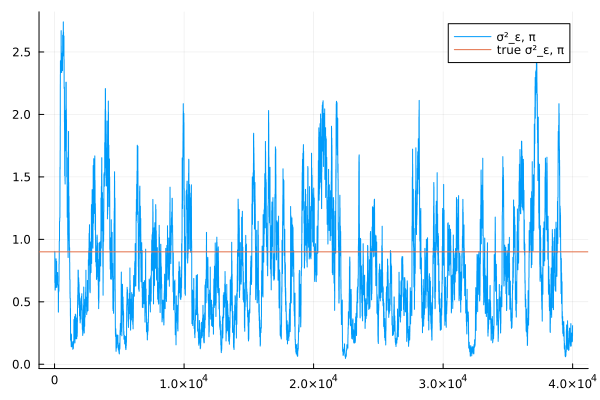

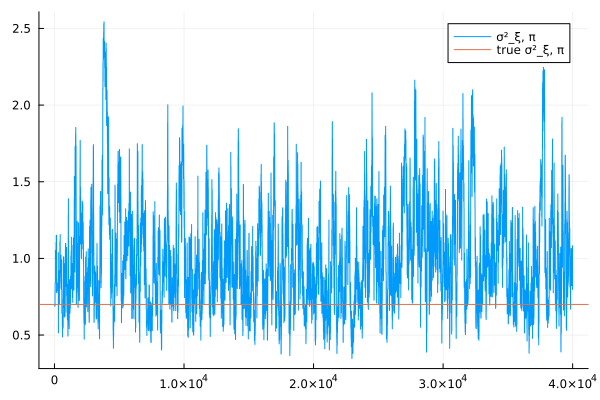

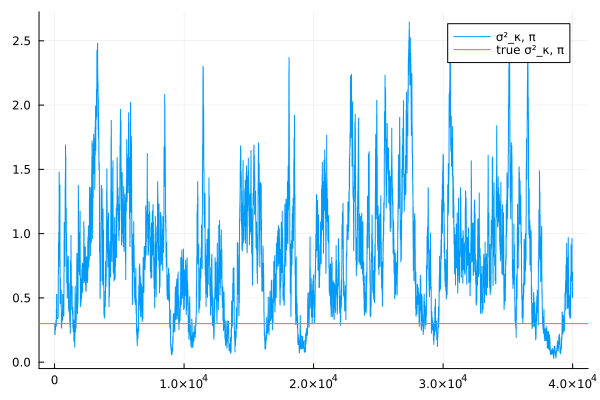

Initial chain shape: (40000, 13)


In [37]:
println("Initial chain shape: ", size(θ_chain_init))
#Print trace plot and add true value
for i in 1:size(θ_chain_init, 2)
    plot(θ_chain_init[:,i], label="$(θ_elements[i])")
    hline!([θ_true[i]], label="true $(θ_elements[i])")
    display(plot!())
end

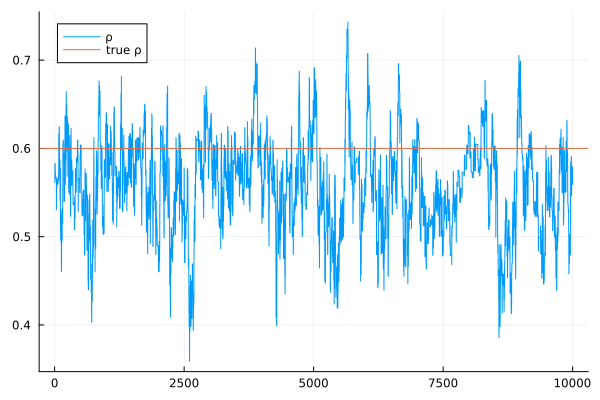

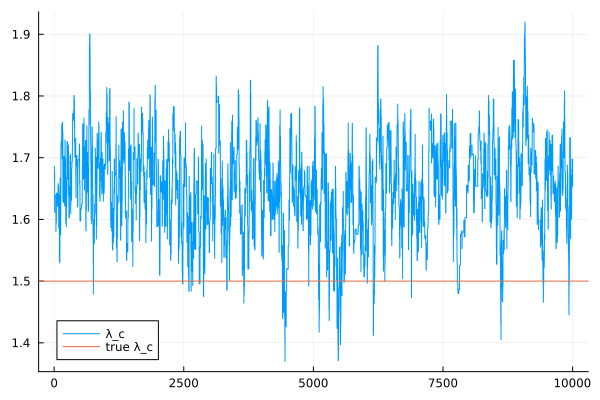

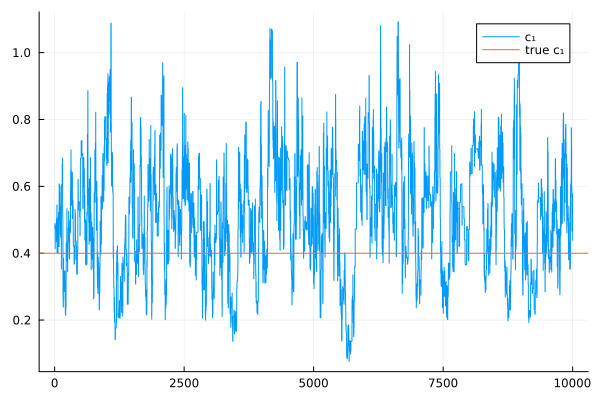

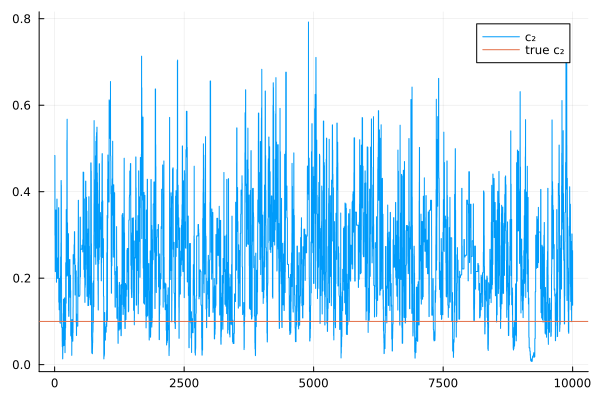

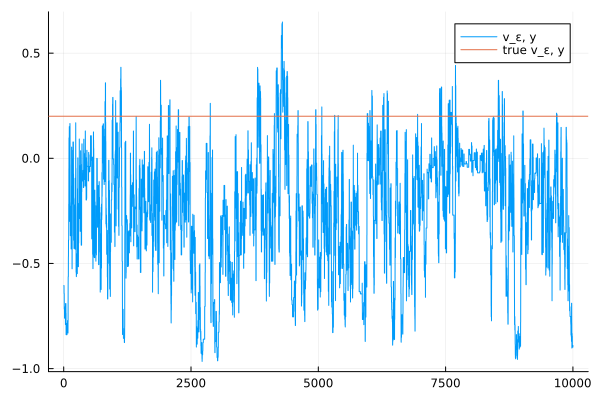

...

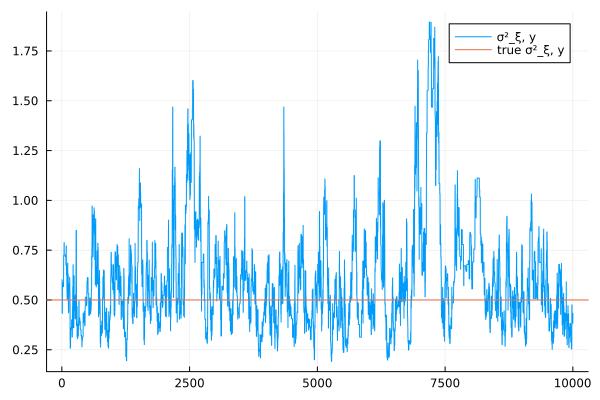

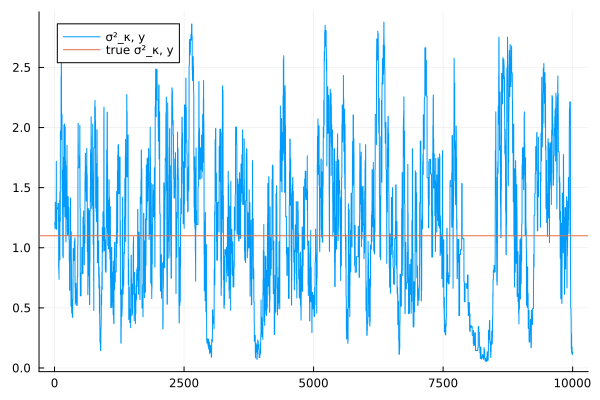

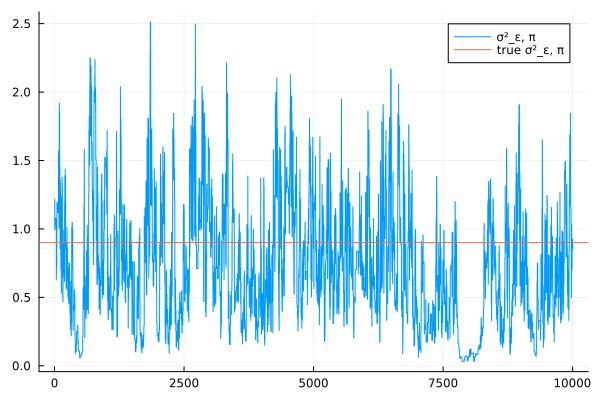

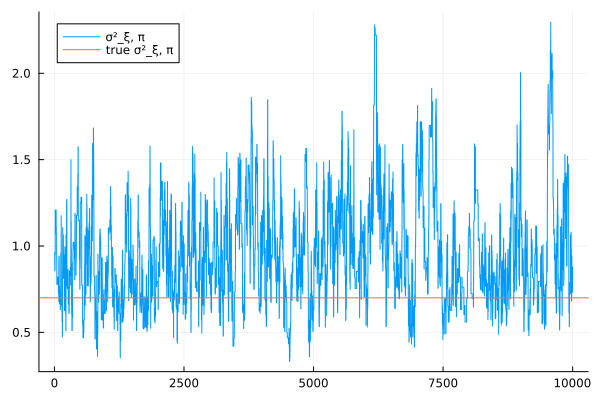

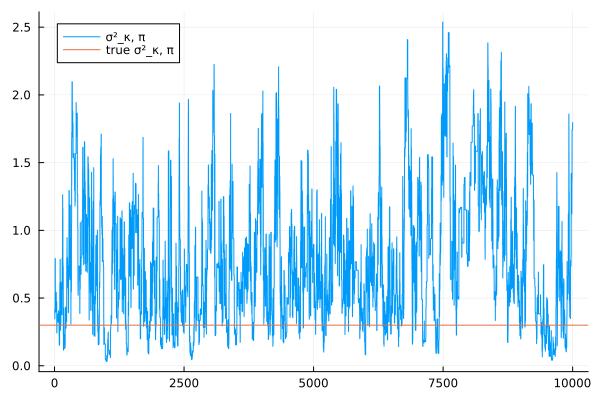

Rec chain shape: (10000, 13)


In [38]:
println("Rec chain shape: ", size(θ_chain))

#Print trace plot and add true value
for i in 1:size(θ_chain, 2)
    plot(θ_chain[:,i], label="$(θ_elements[i])")
    hline!([θ_true[i]], label="true $(θ_elements[i])")
    display(plot!())
end



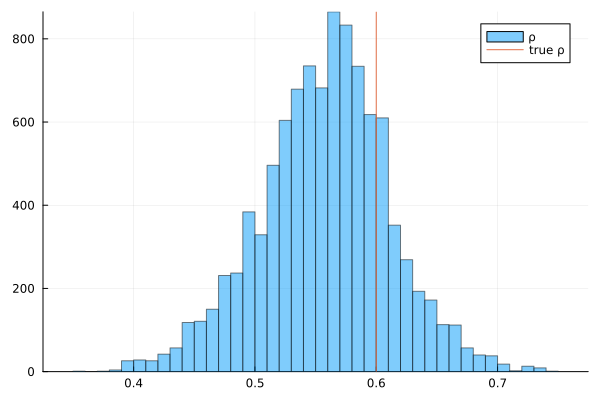

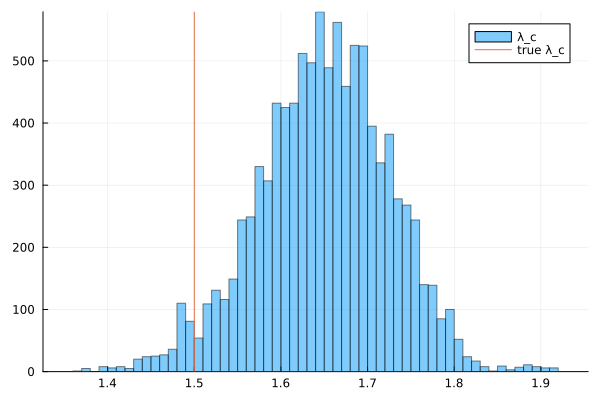

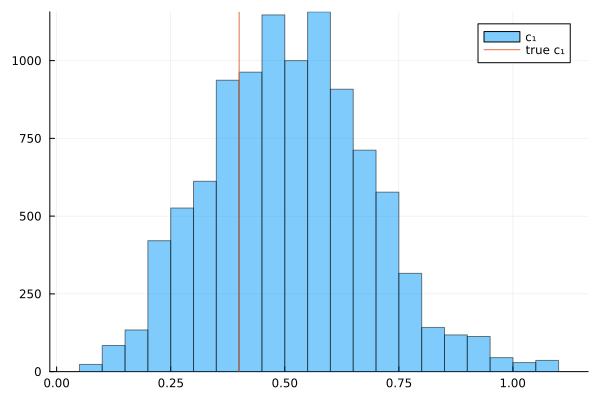

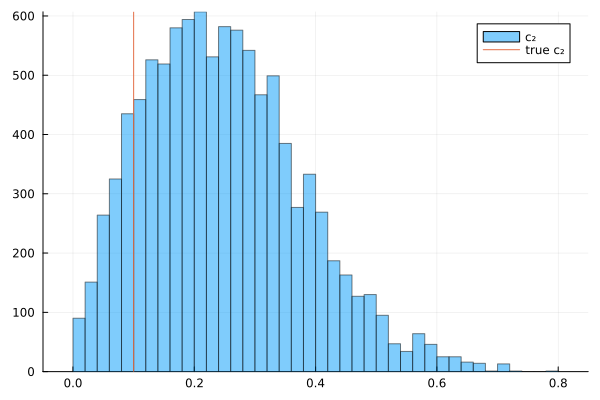

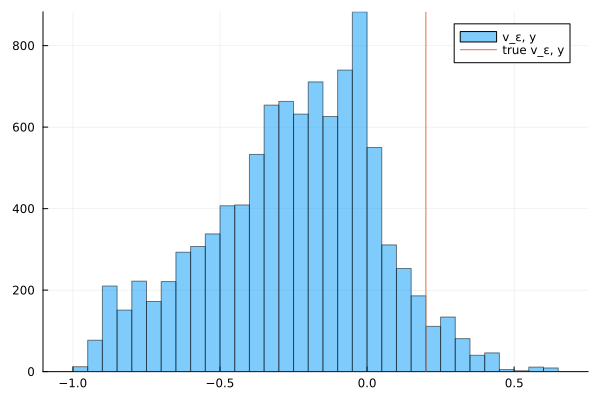

...

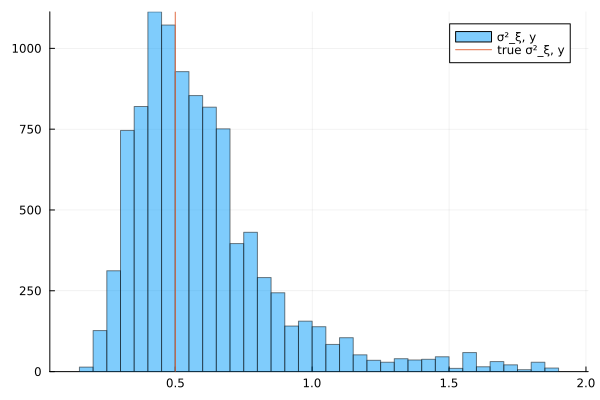

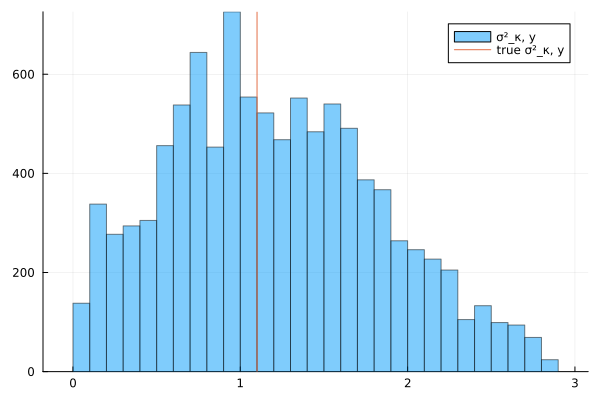

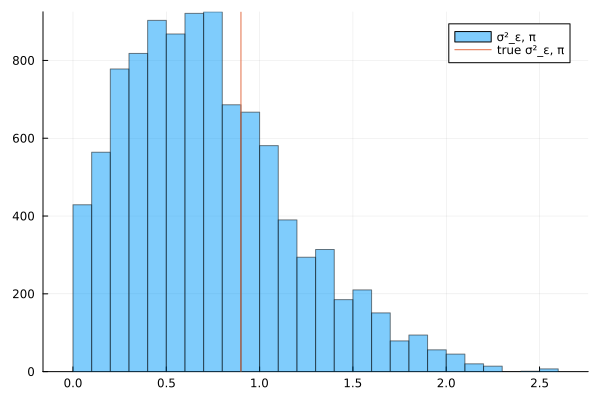

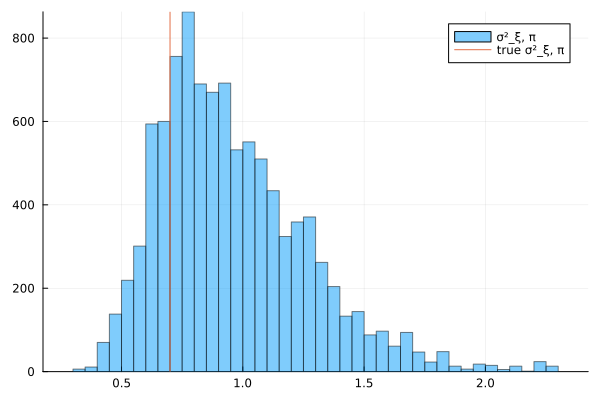

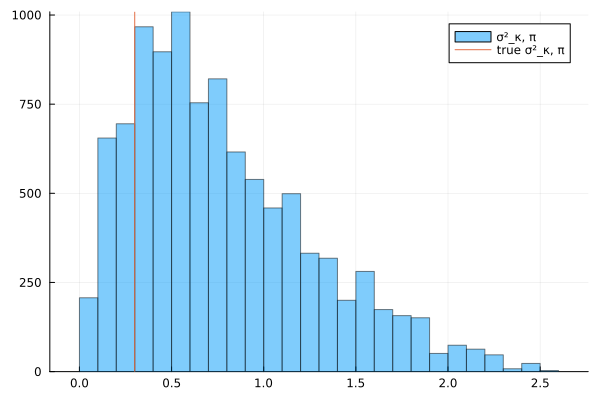

In [39]:
# plot histograms of the chains and add line at true value
for i in 1:size(θ_chain, 2)
    histogram(θ_chain[:,i], label="$(θ_elements[i])", alpha=0.5)
    vline!([θ_true[i]], label="true $(θ_elements[i])")
    display(plot!())
end

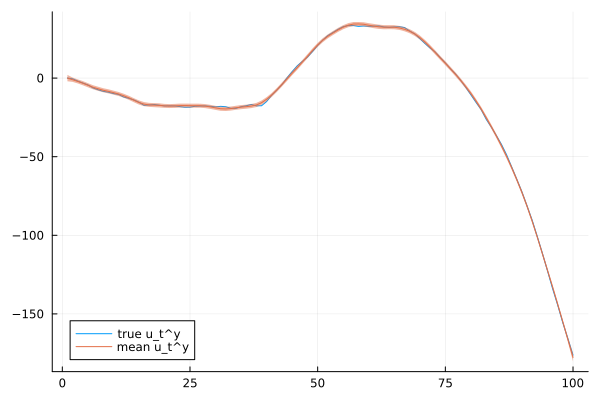

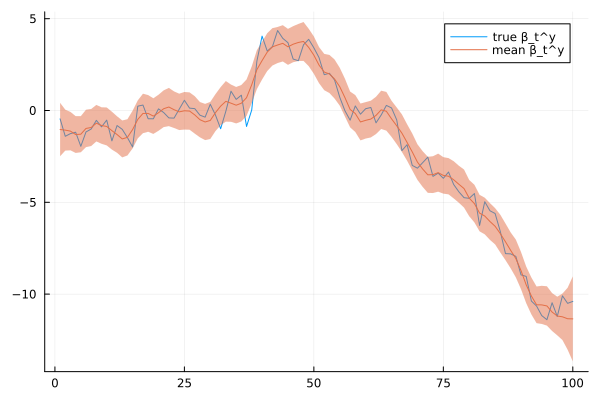

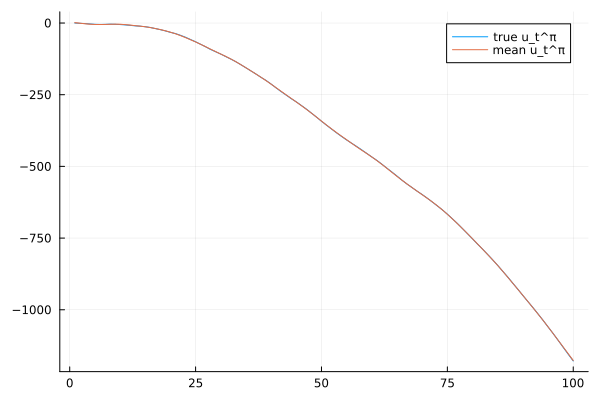

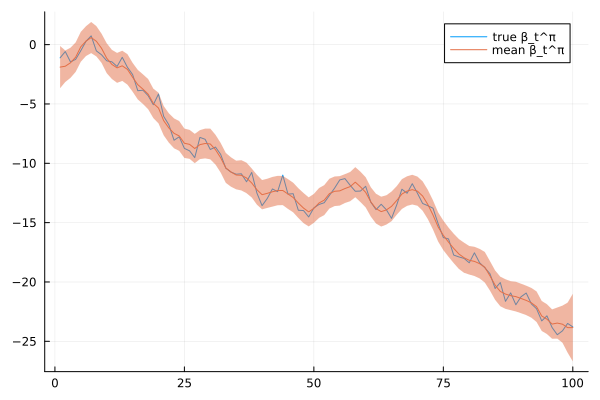

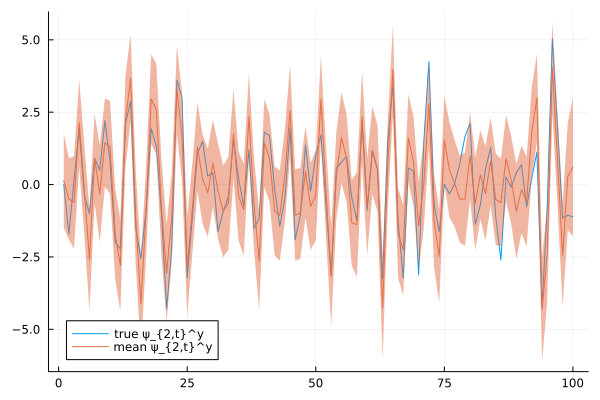

...

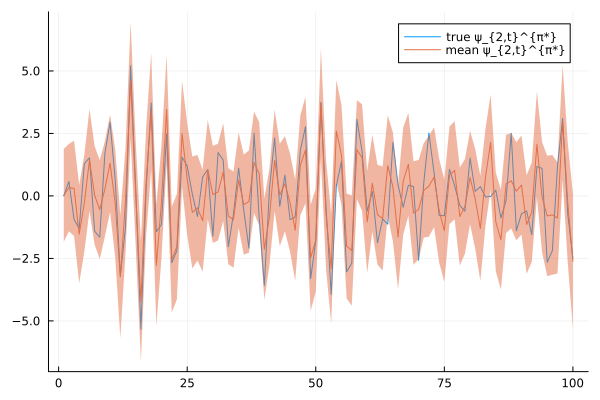

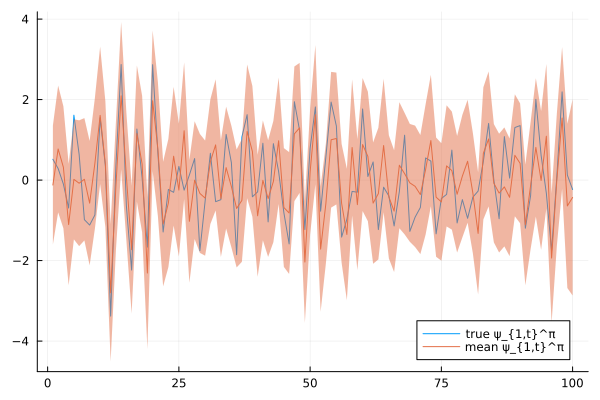

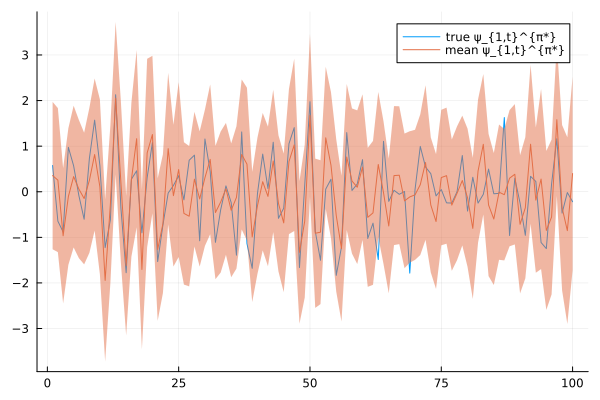

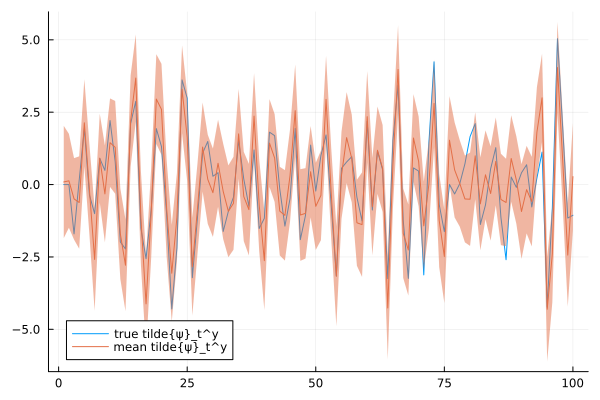

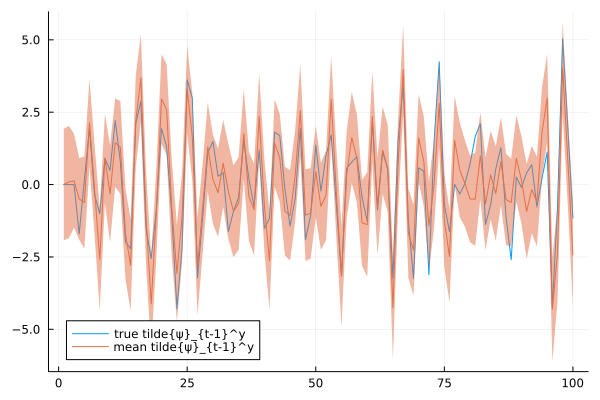

Mean of α_draws: (1, 100, 14)


In [40]:
# Compute the mean over iterations (dimension 1)
α_mean = mean(α_draws, dims=1)
println("Mean of α_draws: ", size(α_mean))

# Compute the 2.5% and 97.5% quantiles 
α_ci = mapslices(x -> quantile(x, [0.025, 0.975]), α_draws, dims=1)



# Plot true states, mean of states, and confidence intervals of states
for i in 1:size(α_mean, 3)
    plot(α[:, i], label="true $(α_elements[i])")
    plot!(α_mean[1, :, i], ribbon=(α_ci[2, :, i] .- α_mean[1, :, i]), label="mean $(α_elements[i])")
    display(plot!())
end


## MLE

In [41]:
# using Optim

# # # True parameters
# # ρ = 0.9
# # λ_c = 0.1
# # c₁ = 0.1
# # c₂ = 0.1
# # v_ε = 1e-4
# # v_ξ = 1e-4
# # v_κ = 1e-4  
# # σ²_ε_y = 0.3
# # σ²_ξ_y = 0.5
# # σ²_κ_y = 0.8
# # σ²_ε_π = 0.01
# # σ²_ξ_π = 0.07
# # σ²_κ_π = 0.03


# lower_bounds = [0.0, 0.0, 0.0, 0.0, 0.0, 0, 0, 0, 0, 0, 0, 0, 0]
# upper_bounds = [1.0, 3.0, 3.0, 3.0, 3.0, 1, 1, 1, 1, 1, 1, 1, 1]
# θ_init = θ_true 
# objective(θ) = neg_log_likelihood(θ, obs, α0, P0, cycle_order)
# res = optimize(objective, lower_bounds, upper_bounds, θ_init, Fminbox(BFGS()))

# # Extract the estimated parameters
# θ_est = Optim.minimizer(res)

# # Print the results:
# println("\nMLE Results (with bounded optimization):")
# for (i, param_name) in enumerate(θ_elements)
#     println("Estimated $(param_name): $(θ_est[i])   (True value: $(θ_true[i]))")
# end
# println("\nFinal negative log-likelihood: ", Optim.minimum(res))


In [42]:
# # estimate states
# LogL_diff, α_diff, P_diff = diffuse_kalman_filter(obs, θ_est, α0, P0, cycle_order, true, false)

# #plot estimated states and true states
# for i in 1:size(α,2)
#     plot(α[:,i], label="true $(α_elements[i])")
#     plot!(α_diff[:,i], label="estimated $(α_elements[i])")
#     display(plot!())
# end

